<a  target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Spectrogram Plotting with plotly

Requirements:   
- plotly   
- spchutils   

In [ ]:
#<a href="https://colab.research.google.com/github/compi1234/spchlab/blob/master/session3/hillenbrand-1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# You may need to install following packages
# !pip install plotly=4.12
# !pip install git+https://github.com/compi1234/spchutils.git
# !pip install pydub
try:
  import google.colab
  IN_COLAB = True
except:
  IN_COLAB = False

In [1]:
import os,sys 
import numpy as np
import pandas as pd
from IPython.display import display, Audio, HTML
import soundfile as sf

import plotly 
import plotly.graph_objects as go
from plotly.subplots import make_subplots
print(plotly.__version__)

#
import spchutils.spectrogram as specg
import spchutils.audio as audio
import spchutils.utils as spch

4.12.0


In [2]:
# set basename and directories
dir='https://raw.githubusercontent.com/compi1234/spchlab/master/data/'
file = "timit/si1027" #@param {type:"string"}
basename = dir+file
wavfname = basename + ".wav"
wrdfname = basename + ".wrd"
phnfname = basename + ".phn"

# 1. read the waveform data
wavdata, sr = audio.load(wavfname)
nsamples = len(wavdata)
etime = float(nsamples)/float(sr)
wavtime = np.arange(0, nsamples)/float(sr)
wavrange = 1.2*np.max(np.abs(wavdata))

# 2. compute spectrogram
fshift = 0.01
spgdata = specg.spectrogram(wavdata,sample_rate=sr,frame_shift=fshift*1000.,n_mels=None)
(nparam,nfr) = spgdata.shape
spg_xaxis = (np.arange(nfr)+0.5)*fshift
spg_yaxis = np.arange(nparam)*sr/(2.*(nparam-1))

# 3. get segmentations
segwrd = pd.read_csv(wrdfname,delim_whitespace=True,names=['t0','t1','seg'])
segphn = pd.read_csv(phnfname,delim_whitespace=True,names=['t0','t1','seg'])
# convert sample based segmentations to time based segmentations
segphn['t0']=spch.indx2t(segphn['t0'],1./sr)
segphn['t1']=spch.indx2t(segphn['t1'],1./sr)
segwrd['t0']=spch.indx2t(segwrd['t0'],1./sr)
segwrd['t1']=spch.indx2t(segwrd['t1'],1./sr)

## 1. Elementary Waveform and Heatmap plotting using plotly

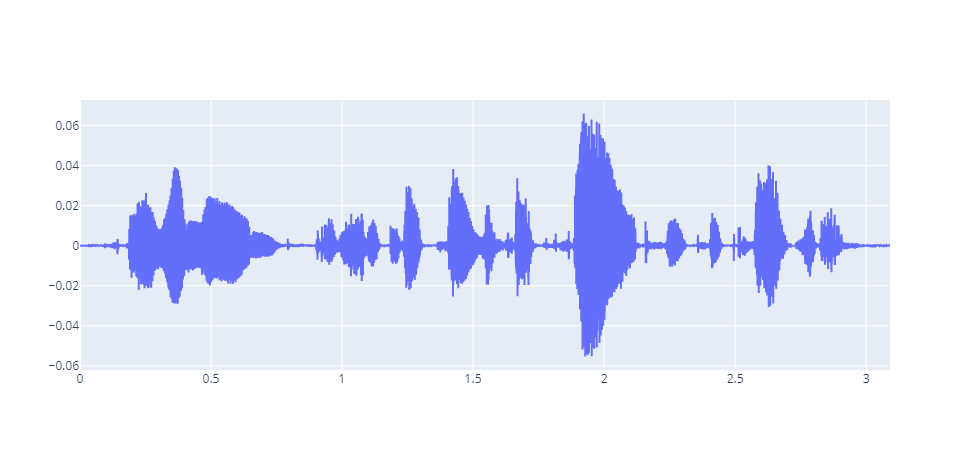

In [3]:
wave_go = go.Scatter(y=wavdata, dx=1./sr,
                  showlegend=False,
                  hoverinfo="x+y",
                 )
go.Figure(wave_go).show()

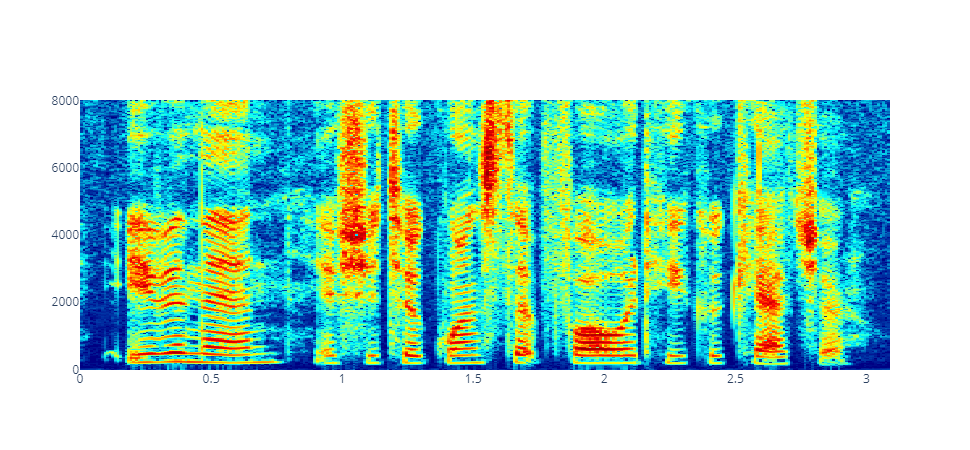

In [4]:
spg_go = go.Heatmap(z=spgdata,dx=fshift,x0=fshift/2.,dy=sr/(2*(nparam-1)),
                 colorscale='Jet',
                 showscale=False,
                 showlegend=False,
                 hoverinfo="x+y+z",
                 name='Spectrogram',
                 text=spgdata)
go.Figure(spg_go).show()

## 2. A high level API for plotly plots of waveform, segmentations and spectrograms

In [78]:
def add_line_plot(fig,y,x=None,dx=1.,xlim='tight',ylim='tight',grid='False',title=None,xlabel=None,ylabel=None,row=1,**kwargs):
    fig.add_trace(go.Scatter(y=y, dx=dx,
                      showlegend=False,
                      hoverinfo="x+y",
                     ),row,1 )
    
    if ylim == 'tight':
        yrange = 1.2*np.max(np.abs(y))
    elif ylim == None:
        pass
    else:
        yrange = ylim
        
    xrange = float(len(y)-1) * dx
    # it is best to add these ranges EXPLICITLY in the figure object
    # as you can not querry this later unless via JavaScript
    fig.update_xaxes(title_text=xlabel,range=[0,xrange])
    fig.update_yaxes(title_text=ylabel,fixedrange=True,range=[-yrange,yrange])
    fig.update_layout(title_text=title)
    
# makes a graphics object (Scatter) of a text transcription
# segmentation is given as a dataframe with columns [t0,t1,seg]  (t0,t1 expressed in secs)
# frameshift is a multiplication factor that can be applied to convert frame numbers to 
#   secs, typically then 0.01 
def go_seg_txt(segdf,frameshift=1.0,textfont={'color':'black','size':14},ypos=0.5):
    nseg = len(segdf)
    btime = np.array(segdf.t0)*frameshift
    etime = np.array(segdf.t1)*frameshift
    _xpos = 0.5*(btime + etime)
    _ypos = ypos*np.ones(nseg)
    segtxt = go.Scatter(x=_xpos,y=_ypos,text=segdf.seg,mode='text',
                  textfont=textfont,
                  hoverinfo="x+text",
                  showlegend=False)
    return segtxt

# The position of the segmentation is relative height in the current axis
def add_seg_plot(fig,segdf,ypos=0.8,textfont={'color':'red','size':18},Lines=True,row=1):

    yax = 'yaxis'+str(row) if (row > 1) else   'yaxis'
    yrange = fig['layout'][yax].range
    #yrange = fig.layout.yaxis.range
    if yrange is None: yrange = (0.,1.)
    _ypos = yrange[0]+ypos*(yrange[1]-yrange[0])
    segdf_go = go_seg_txt(segdf,textfont=textfont,ypos=_ypos)
    fig.add_trace(segdf_go,row,1)
    if Lines:
        for iseg in range(0,len(segdf)):
            fig.add_vline(row=row,x=segdf['t0'][iseg], line_dash='dash',line_color='green')
            fig.add_vline(row=row,x=segdf['t1'][iseg], line_dash='dot',line_color='green')

def plot_waveform(waveform, sample_rate, title=None, **kwargs):
    '''
    Single channel waveform plotting
    
    '''

    layout1 = dict(title="Waveform",
             xaxis=dict(title="Time(sec)",zeroline=False,showgrid=False),
             yaxis=dict(zeroline=False,fixedrange=True,showgrid=False))   
    fig = go.Figure(layout=layout1)
    fig = make_subplots(rows=1, cols=1, row_heights=[1.],
                   shared_xaxes=True,
                   vertical_spacing=0.02,
                   start_cell='bottom-left')
    
    add_line_plot(fig,waveform,dx=1./sample_rate, title=title)
    return(fig)

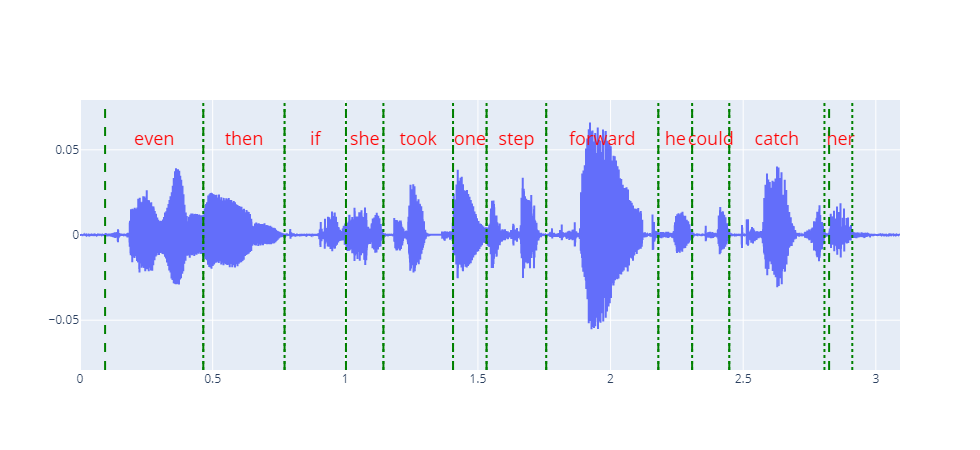

In [73]:
fig = plot_waveform(wavdata, sr)
add_seg_plot(fig,segwrd,ypos=.85)
display(fig)

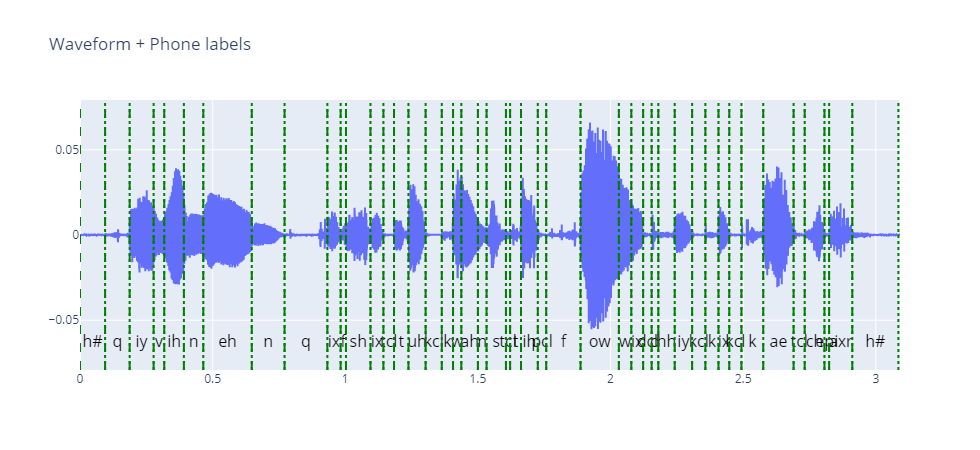

In [83]:
fig = plot_waveform(wavdata, sr,title="Waveform + Phone labels")
add_seg_plot(fig,segphn,ypos=.1,textfont={'color':'black','size':16})
display(fig)

## SPECTROGRAM PLOT in plotly
    - using subplots to allow for waveform / spectrogram / segmentations ..

1. Generate the subplot framework
    - make a cellgrid with a specified number of (rows,cols)   
    - You can span single subplots over a range of cells   
2. Add traces   
    - refer to cells in the grid (counting starts at 1 !!!!)
    - when using a plot over mulitple cells, give position (TOP,LEFT) 
    - For adding layout features: refer to the number of the plot ..   

Known Limitations:
- Rangeslider: 
    + selects automatically the trace of the first subplot to show in range slider (in plotly.js this is possible via showtraces, not in python) and shows it immediately below, which actually enforces one to use start_cell = bottom-left 
    + no event listener to get the rangeslider boundaries. e.g. for selective audio play
- subplots: many layout features, such as background color, can not be controlled at the subplot level
- interactivity: 
    + no event listener for rangeslider

In [80]:
def add_hm_plot(fig,data,dx=None,x0=0,dy=1,row=1,col=1):
#    hm_go = go.Heatmap(z=data,dx=fshift,x0=fshift/2.,dy=sr/(2*(nparam-1)),    
    fig.add_trace( go.Heatmap(z=data,dx=dx,x0=x0,dy=dy,
                 colorscale='Jet',
                 showscale=False,
                 showlegend=False,
                 hoverinfo="x+y+z",
                 name='',
                 text=data) , row, col )
    (ny,nx)=data.shape
    yrange = [0.,(ny-1)*dy]
    fig.update_yaxes(row=row,range=yrange,fixedrange=True,title_text='Frequency(hz)')

def spg_plot(spg,wav=None,sample_rate=None,shift=0.01,segwav=None,segspg=None,title="Spectrogram"):

    if wav is None:
        nrows = 1
        heights = [1.]
    else:
        nrows = 2
        heights = [.3,.7]

    fig = make_subplots(rows=nrows, cols=1, row_heights=heights,
                   shared_xaxes=True,
                   vertical_spacing=0.02,
                   start_cell='bottom-left')

    (nparam,nfr) = spg.shape
    row_wav = 1
    if wav is not None:
        add_line_plot(fig,wav,dx=1./sample_rate,row=1)
        row_spg = 2
        row_wav = 1          
    else:
        row_spg = 1

    if segwav is not None:
        add_seg_plot(fig,segwav,row=row_wav,ypos=0.8)
  
    add_hm_plot(fig,spg,dx=shift,x0=shift/2.,dy=sample_rate/(2.*(nparam-1)),row=row_spg)
    
    if segspg is not None:
        add_seg_plot(fig,segspg,row=row_spg,ypos=.9,textfont={'color':'black','size':16})
    
    fig.update_layout(height=800,width=1000,title_text=title,selectdirection="h",plot_bgcolor="#f0ffff")
    return(fig)

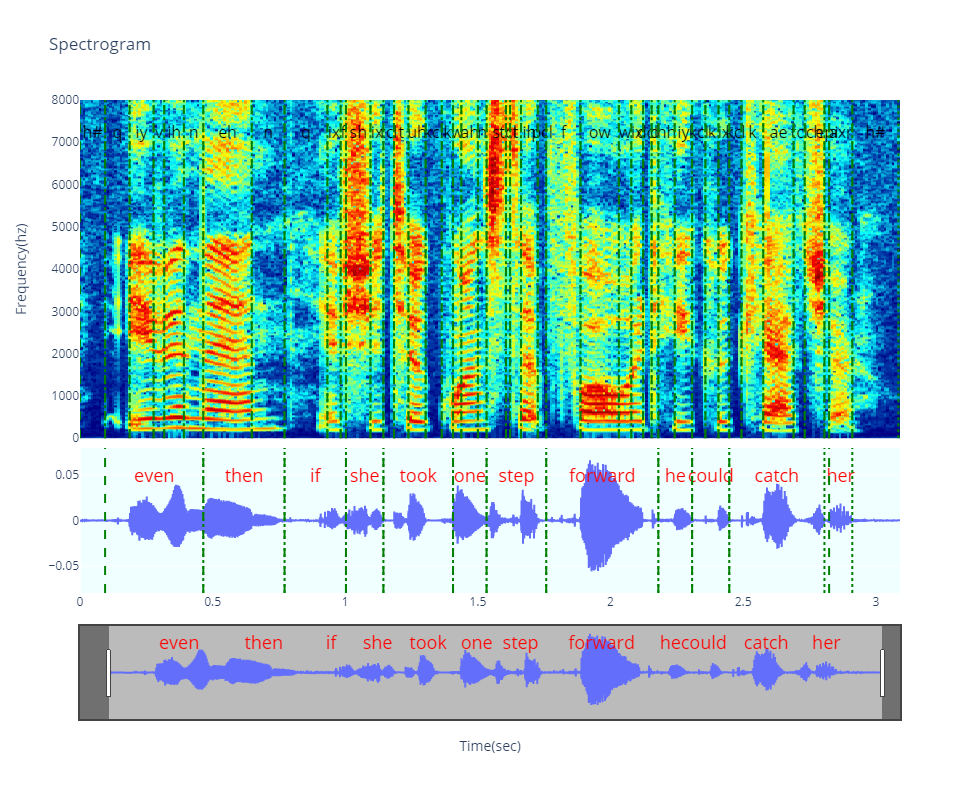

In [81]:
#fig = spg_plot(spgdata,wav=wavdata,sample_rate=sr,shift=fshift,segwav=segwrd,segspg=segphn)
Rangeslider=True
fig = spg_plot(spgdata,wav=wavdata,sample_rate=sr,shift=fshift,segwav=segwrd,segspg=segphn)
if(Rangeslider):
    fig['layout']['xaxis'].update(title='Time(sec)',
                               type='linear',
                               rangeslider=dict(visible=True,borderwidth=2,bgcolor="#bbb"), 
                               showgrid=False)
fig.show()

In [ ]:
fig = make_subplots(rows=3, cols=1, row_heights=[.3,.6,.1],
                   shared_xaxes=True,
                   vertical_spacing=0.02,
                   start_cell='bottom-left')
fig.update_xaxes(showgrid=False,range=[wavtime[0],wavtime[nsamples-1]])
fig.update_yaxes(showgrid=False,fixedrange=True,zeroline=False)


fig.add_trace(wave_go,1,1)
fig.add_trace(segwrd_go1,1,1)
fig.update_yaxes(row=1,title_text='Amplitude',range=[-wavrange,wavrange],zeroline=True)
for iseg in range(0,len(segwrd)):
    fig.add_vline(row=1,x=segwrd['t0'][iseg], line_dash='dash',line_color='blue')
    fig.add_vline(row=1,x=segwrd['t1'][iseg], line_dash='dot',line_color='blue')
    
fig.add_trace(spg_go,2,1)
fig.update_yaxes(row=2,title_text='Frequency(hz)')

fig.add_trace(segphn_go1,3,1)
fig.update_yaxes(row=3,showticklabels=False)
for iseg in range(0,len(segphn)):
    fig.add_vline(row=3,x=segphn['t0'][iseg], line_dash='dash',line_color='black')
    fig.add_vline(row=3,x=segphn['t1'][iseg], line_dash='dot',line_color='black')
    
fig.update_layout(height=800,width=1000,title_text="Waveform + Spectrogram + Segmentation",selectdirection="h",plot_bgcolor="#f0ffff")
#fig['layout'].update(selectdirection="h",plot_bgcolor="#f0ffff")
fig['layout']['yaxis'].update(fixedrange=True,type='linear')
fig['layout']['xaxis2'].update(title='Time(sec)',
                               type='linear',
                               rangeslider=dict(visible=True,borderwidth=2,bgcolor="#bbb",range=[wavtime[0],wavtime[nsamples-1]]), 
                               showgrid=False)
fig.show()
display(Audio(data=wavdata,rate=sr))



In [55]:
fig['layout']['yaxis2'].range

(0.0, 8000.0)

In [41]:
fig.update_xaxes(showgrid=False,range=[wavtime[0],wavtime[nsamples-1]])
fig.update_yaxes(showgrid=False,fixedrange=True,zeroline=False)


fig.add_trace(wave_go,1,1)
fig.add_trace(segwrd_go1,1,1)
fig.update_yaxes(row=1,title_text='Amplitude',range=[-wavrange,wavrange],zeroline=True)
for iseg in range(0,len(segwrd)):
    fig.add_vline(row=1,x=segwrd['t0'][iseg], line_dash='dash',line_color='blue')
    fig.add_vline(row=1,x=segwrd['t1'][iseg], line_dash='dot',line_color='blue')
    
fig.add_trace(spg_go,2,1)
fig.update_yaxes(row=2,title_text='Frequency(hz)')

fig.add_trace(segphn_go1,3,1)
fig.update_yaxes(row=3,showticklabels=False)
for iseg in range(0,len(segphn)):
    fig.add_vline(row=3,x=segphn['t0'][iseg], line_dash='dash',line_color='black')
    fig.add_vline(row=3,x=segphn['t1'][iseg], line_dash='dot',line_color='black')
    
fig.update_layout(height=800,width=1000,title_text="Waveform + Spectrogram + Segmentation",selectdirection="h",plot_bgcolor="#f0ffff")
#fig['layout'].update(selectdirection="h",plot_bgcolor="#f0ffff")
fig['layout']['yaxis'].update(fixedrange=True,type='linear')
fig['layout']['xaxis'].update(title='Time(sec)',
                               type='linear',
                               rangeslider=dict(visible=True,borderwidth=2,bgcolor="#bbb",range=[wavtime[0],wavtime[nsamples-1]]), 
                               showgrid=False)
fig.show()
display(Audio(data=wavdata,rate=sr))

NameError: name 'segwrd_go1' is not defined